In [1]:
# THIS PROJECT HAS BEEN REFACTORED SINCE I PUT IT UP ON GITHUB
# https://github.com/jackzellweger/rent-to-sale-price-ratios/blob/main/calculate-ratios.py

In [88]:
# LIBRARY IMPORTS
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import pandas as pd
import geopandas as gpd
from pathlib import Path  
import folium
import branca
import json

In [3]:
# DATA IMPORTS
# 2022
    # sales = pd.read_csv('Redfin_SalePricesByZip.tsv000', sep='\t',header=0)
    # rentals = pd.read_csv('Zip_ZORI_AllHomesPlusMultifamily_Smoothed.csv', sep=',',header=0)
# 2023
sales = pd.read_csv('jan-2023/zip_code_market_tracker.tsv000', sep='\t',header=0)
rentals = pd.read_csv('jan-2023/Zip_zori_sm_month.csv', sep=',', header=0, converters={'RegionName': lambda x: x.zfill(5)})

In [4]:
#list(sales.columns.values)
#list(rentals.columns.values)

In [5]:
# USEFUL SCRIPTS
    # currentRentalPrices.dtypes
    # currentSalesPrices.dtypes
    # sales.columns;
    # with pd.option_context('display.max_rows', 5, 'display.max_columns', None): 
         # display(salesCleanedZip[(salesCleanedZip['region'] == '90266')].head(5))

# PARKING LOT
    # s1 = rentalsAndSalesSorted[100000:-100000].plot(figsize=(40,20));
    # s1.figure.savefig('/Users/jackzellweger/Desktop/filename.png');
    # Isolate 'region' and 'median_sale_price' preserving the index (1, 2, 3...)
        # currentSalesPrices = sales.filter(items=['region','median_sale_price'])
    # Remove everything except the zip code
        # currentSalesPrices['region'] = currentSalesPrices['region'].str.extract('(\d+)')
    # This is an alternate that extracts the string as an int instead of a str
        # currentSalesPrices['region'] = currentSalesPrices['region'].str.extract('(\d+)').astype(int)
    # Isolate the 'region' and 'median_sale_price', then groups, and takes the mean of the zips
        # salesByZip = currentSalesPrices.groupby(['RegionName']).mean()

In [6]:
# SALES DATA COLLECTION & CLEANING
# SOLVES THE PROBLEM OF SALES DATA W/ MULTIPLE ZIPS

# Take the data from just 2022
salesCleanedZip = sales[sales["period_begin"].str.contains("2022")]

# Clean up the zips
salesCleanedZip['region'] = sales['region'].str.extract('(\d+)')

# Simplify the dataframe, isolating the 'region' and 'median_sale_price'
# salesSimplified = salesCleanedZip[['region', 'median_sale_price']]
salesSimplified = salesCleanedZip.filter(items=['region','median_sale_price'])

# Isolate the 'region' and 'median_sale_price', then groups, and takes the mean of the zips
# salesByZip = salesSimplified.groupby(['region']).mean()
salesByZip = salesSimplified.groupby(['region']).median()

# Reset the index
# We might not need this if we use the .filter() dot-extension above.
salesByZip = salesByZip.reset_index()

# Rename the column 'region' to 'RegionName'
salesByZip = salesByZip.rename(columns={'region':'RegionName'})

# Rename the column 'median_sale_price' to 'CurrentSalesPrice'
salesByZip = salesByZip.rename(columns={'median_sale_price':'CurrentSalesPrice'})

/var/folders/dj/yd_369kx231256n8rxsw9wlh0000gn/T/ipykernel_42323/4117213973.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  salesCleanedZip['region'] = sales['region'].str.extract('(\d+)')


In [7]:
# Sanity checks
# salesByZip
# salesByZip.loc[salesByZip['RegionName'] == '90266']
# rentalsAndSales.loc[rentalsAndSales['RegionName'] == '90266']
# rentalsAndSales.loc[['10017']]
# booleanSales = salesByZip['RegionName'].duplicated().any()
# booleanSales

In [8]:
# RENTAL DATA COLLECTION & CLEANING

t1=rentals[['RegionName']].join(rentals.filter(regex='2022'))
t2=t1.melt(id_vars='RegionName', var_name='Date', value_name='CurrentRentalPrice')
currentRentalPrices = t2.groupby('RegionName').median().reset_index()

# currentRentalPrices = rentals.filter(items=['RegionName','2022-11-30'])
# currentRentalPrices = currentRentalPrices.rename(columns={'2022-11-30':'CurrentRentalPrice'})
# currentRentalPrices = currentRentalPrices['RegionName'].astype(str).apply(lambda x: x.zfill(5))

# currentRentalPrices[currentPrices.CurrentPrice > 9000]
# currentRentalPrices[currentPrices.RegionName == 90266]

In [9]:
# Ensuring that there aren't any duplicate Zip codes in the rental table
booleanRentals = currentRentalPrices['RegionName'].duplicated().any()

In [10]:
# JOINING THE DATABASE, CLEANING, & CALCULATING RENT:SALES
combined=salesByZip.set_index('RegionName').join(currentRentalPrices.set_index('RegionName'))
rentalsAndSales = combined.dropna()
rentalsAndSales["RentToSaleRatio"] = rentalsAndSales["CurrentRentalPrice"]/rentalsAndSales["CurrentSalesPrice"]

/var/folders/dj/yd_369kx231256n8rxsw9wlh0000gn/T/ipykernel_42323/215701630.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rentalsAndSales["RentToSaleRatio"] = rentalsAndSales["CurrentRentalPrice"]/rentalsAndSales["CurrentSalesPrice"]


In [11]:
rentalsAndSales

,CurrentSalesPrice,CurrentRentalPrice,RentToSaleRatio
RegionName,,,
01001,262750.0,2195.000000,0.008354
01002,450000.0,2660.000000,0.005911
01085,285000.0,1405.406962,0.004931
01420,330000.0,1226.683518,0.003717
01453,380000.0,1609.295870,0.004235
...,...,...,...
99507,355000.0,1468.788424,0.004137
99508,312250.0,1657.917754,0.005310
99517,350000.0,1398.771070,0.003996


In [116]:
# SAMPLING THE TOP XX ZIP CODES
# rentalsAndSalesSorted[0:10]

# FILTERING OUT THE OUTLIARS
rentalsAndSalesFiltered = rentalsAndSales[rentalsAndSales.RentToSaleRatio < .015]
rentalsAndSalesSorted = rentalsAndSalesFiltered.sort_values(by='RentToSaleRatio', ascending=False)

# What does the dataframe look like?
[rentalsAndSalesSorted]

[            CurrentSalesPrice  CurrentRentalPrice  RentToSaleRatio
 RegionName                                                        
 45402                 95700.0         1408.342548         0.014716
 24541                 99900.0         1450.000000         0.014515
 45417                 63500.0          905.229411         0.014256
 44707                 88650.0         1255.000000         0.014157
 21223                 93650.0         1324.651981         0.014145
 ...                       ...                 ...              ...
 10065               4833750.0         3641.938241         0.000753
 83404               2081250.0         1386.014099         0.000666
 10014               7805000.0         4683.395707         0.000600
 75207               3022500.0         1696.712291         0.000561
 85122                341990.0           75.672657         0.000221
 
 [5650 rows x 3 columns]]

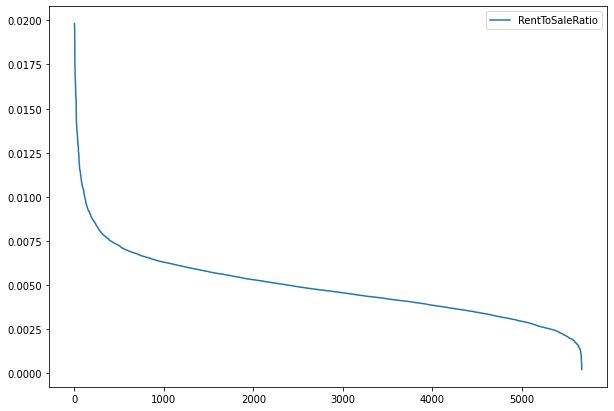

In [13]:
# PLOTTING THE ZIP CODES BY RENT:SALES
s2=rentalsAndSalesSorted.plot(y='RentToSaleRatio',figsize=(10,7), use_index=False);

In [14]:
# SAMPLING VARIOUS REGIONS
[rentalsAndSalesSorted.tail(10)]


[            CurrentSalesPrice  CurrentRentalPrice  RentToSaleRatio
 RegionName                                                        
 94010               2592250.0         3003.090205         0.001158
 92661               4187500.0         4688.615909         0.001120
 11217               3399000.0         3701.201914         0.001089
 92663               2475000.0         2340.557026         0.000946
 10024               4350000.0         3698.616969         0.000850
 10065               4833750.0         3641.938241         0.000753
 83404               2081250.0         1386.014099         0.000666
 10014               7805000.0         4683.395707         0.000600
 75207               3022500.0         1696.712291         0.000561
 85122                341990.0           75.672657         0.000221]

In [129]:
# SAMPLING VARIOUS REGIONS
[rentalsAndSalesSorted.head(91)]

[            CurrentSalesPrice  CurrentRentalPrice  RentToSaleRatio
 RegionName                                                        
 45402                 95700.0         1408.342548         0.014716
 24541                 99900.0         1450.000000         0.014515
 45417                 63500.0          905.229411         0.014256
 44707                 88650.0         1255.000000         0.014157
 21223                 93650.0         1324.651981         0.014145
 ...                       ...                 ...              ...
 06510                229500.0         2347.427560         0.010228
 21205                134250.0         1364.152664         0.010161
 14619                130000.0         1320.371202         0.010157
 60301                199875.0         2025.761115         0.010135
 64128                101000.0         1018.722090         0.010086
 
 [91 rows x 3 columns]]

In [16]:
# EXPORTING 4 COLUMNS
# filepath = Path('data_output/out.csv')  
# filepath.parent.mkdir(parents=True, exist_ok=True)  
# rentalsAndSalesSorted[250:260].to_csv(filepath)

In [17]:
# EXPORTING FOR MATHEMATICA (2 COLUMNS)
filepath = Path('data_output/out.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True)  
rentalsAndSalesSorted.loc[:,'RentToSaleRatio'][0:1800].to_csv(filepath)

In [18]:
# Portland, Oregon
rentalsAndSalesSorted[rentalsAndSalesSorted.index.str.startswith('9026')].head(10)

,CurrentSalesPrice,CurrentRentalPrice,RentToSaleRatio
RegionName,,,
90265,3808750.0,14018.168530,0.003681
90260,800000.0,2593.916657,0.003242
90266,3183000.0,5122.858331,0.001609


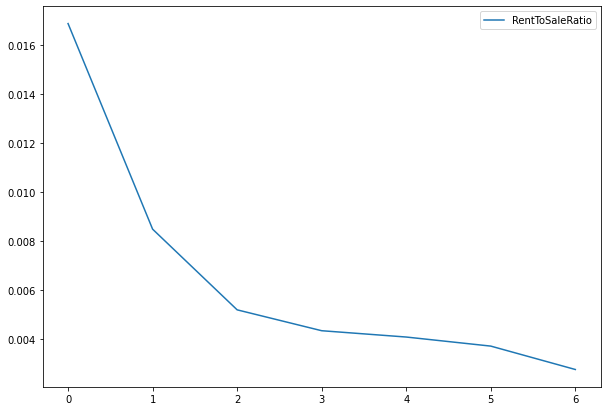

In [19]:
# Portland, Oregon
rentalsAndSalesSorted[rentalsAndSalesSorted.index.str.startswith('6310')].plot(y='RentToSaleRatio',figsize=(10,7), use_index=False);

In [20]:
# PROCESSING FOR WEB

In [21]:
shapefile = 'cb_2020_us_zcta520_500k/cb_2020_us_zcta520_500k.shp'
gdf = gpd.read_file(shapefile)

In [22]:
#gdf.head(2)

In [23]:
#gdf.sort_values('NAME20').tail(10).plot()

In [118]:
gdf1

,CurrentSalesPrice,CurrentRentalPrice,RentToSaleRatio,ZCTA5CE20,AFFGEOID20,GEOID20,LSAD20,ALAND20,AWATER20,geometry
RegionName,,,,,,,,,,
01001,262750.0,2195.000000,0.008354,01001,860Z200US01001,01001,Z5,29247431,2127894,"POLYGON ((-72.66768 42.04502, -72.65771 42.050..."
01002,450000.0,2660.000000,0.005911,01002,860Z200US01002,01002,Z5,137931897,4280973,"POLYGON ((-72.54582 42.41014, -72.54420 42.427..."
01085,285000.0,1405.406962,0.004931,01085,860Z200US01085,01085,Z5,154690428,2940567,"POLYGON ((-72.85747 42.23004, -72.85786 42.234..."
01420,330000.0,1226.683518,0.003717,01420,860Z200US01420,01420,Z5,77850259,1793220,"POLYGON ((-71.86273 42.54866, -71.86251 42.552..."
01453,380000.0,1609.295870,0.004235,01453,860Z200US01453,01453,Z5,68269233,1190779,"POLYGON ((-71.84201 42.51463, -71.84006 42.514..."
...,...,...,...,...,...,...,...,...,...,...
99507,355000.0,1468.788424,0.004137,99507,860Z200US99507,99507,Z5,122467895,27589,"POLYGON ((-149.86065 61.18085, -149.84940 61.1..."
99508,312250.0,1657.917754,0.005310,99508,860Z200US99508,99508,Z5,18504540,211181,"POLYGON ((-149.86814 61.19785, -149.86816 61.2..."
99517,350000.0,1398.771070,0.003996,99517,860Z200US99517,99517,Z5,8390841,319938,"POLYGON ((-149.97118 61.19143, -149.96774 61.1..."


In [138]:
testo = rentalsAndSalesSorted.join(gdf.set_index('NAME20')).dropna().sort_values('RegionName')
gdf1 = gpd.GeoDataFrame(testo, geometry='geometry')
# gdf1.plot()

m = folium.Map(location=[40.70, -98.94], zoom_start=4.0, tiles='CartoDB positron')

# Create a color map from red to green
color_map = branca.colormap.LinearColormap(['red', 'green'], vmin=0.000, vmax=0.016)

for _, r in gdf1.iterrows():
    shape_column = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    color = color_map(r['RentToSaleRatio'])
    geo_j = shape_column.to_json()
    # print(geo_j['features'])
    geo_j_json = json.loads(geo_j)
    geo_j_json['features'][0]['properties']['ratio'] = r['RentToSaleRatio']
    # print(geo_j_json['features'][0]['properties']['ratio'])
    # print('\n')
    geo_j = folium.GeoJson(data=geo_j_json,
                           style_function=lambda x: {'fillColor': color_map(x['properties']['ratio']), 'color': 'black', 'weight': 0, 'fillOpacity': 0.9})
    folium.Popup(str('{:.2f}% <br> {} <br> ${:,.0f} <br> ${:,.0f} '.format(r['RentToSaleRatio'] * 100, str(r['GEOID20']).zfill(5), r['CurrentSalesPrice'], r['CurrentRentalPrice'] ))).add_to(geo_j)
    geo_j.add_to(m)
m

In [139]:
m.save("heat_map.html")

In [46]:
gdf_geometry=gdf1["geometry"].reset_index().to_json()

In [26]:
gdf_ratios=gdf1["RentToSaleRatio"].to_frame().reset_index()

In [27]:
m = folium.Map(location=[48, -102], zoom_start=3)

folium.Choropleth(
    geo_data=gdf_geometry,
    name="choropleth",
    data=gdf_ratios,
    columns=["RegionName","RentToSaleRatio"],
    key_on="features.RegionName",
    fill_color="YlGn",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Unemployment Rate (%)",
).add_to(m)

folium.LayerControl().add_to(m)

m

AttributeError: 'NoneType' object has no attribute 'get'

In [ ]:
# JACK
gdf2=gdf1["geometry"].to_json()

# TEMPLATE
url = (
    "https://raw.githubusercontent.com/python-visualization/folium/master/examples/data"
)
state_geo = f"{url}/us-states.json"
state_unemployment = f"{url}/US_Unemployment_Oct2012.csv"
state_data = pd.read_csv(state_unemployment)

m = folium.Map(location=[48, -102], zoom_start=3)

folium.Choropleth(
    geo_data=state_geo,
    name="choropleth",
    data=state_data,
    columns=["State", "Unemployment"],
    key_on="feature.id",
    fill_color="YlGn",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Unemployment Rate (%)",
).add_to(m)

folium.LayerControl().add_to(m)

m

In [ ]:
state_geo
state_unemployment
state_data = pd.read_csv(state_unemployment)

In [ ]:
state_geo

In [ ]:
url = (
    "https://raw.githubusercontent.com/python-visualization/folium/master/examples/data"
)
state_geo = f"{url}/us-states.json"
state_unemployment = f"{url}/US_Unemployment_Oct2012.csv"
state_data = pd.read_csv(state_unemployment)

m = folium.Map(location=[48, -102], zoom_start=3)

folium.Choropleth(
    geo_data=geo_j,
    name="choropleth",
    data=state_data,
    columns=["State", "Unemployment"],
    key_on="feature.id",
    fill_color="YlGn",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Unemployment Rate (%)",
).add_to(m)

folium.LayerControl().add_to(m)

m

In [ ]:
geo_j

In [ ]:
m